In [422]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

In [397]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format='retina'

## Devise

In [32]:
import sys
import torch
from fastai.conv_learner import *
torch.backends.cudnn.benchmark=True
import fasttext as ft
import fastai
import torchvision.transforms as transforms

In [33]:
PATH = Path('/imgnet')
TMP_PATH = PATH/'tmp'
TRANS_PATH = Path('data/translate/')
PATH_TRN = PATH/'train'

In [34]:
ft_vecs = ft.load_model(str((TRANS_PATH/'wiki.en.bin')))

In [35]:
ft_vecs.get_word_vector('king')

array([ 0.03259, -0.18164, -0.29049, -0.10506, -0.16712, -0.07748, -0.5661 , -0.08622, -0.00216,  0.15366,
        0.12189, -0.14722,  0.01511,  0.07209, -0.02156, -0.20612, -0.02104, -0.01999, -0.15506,  0.00802,
       -0.22746,  0.33518, -0.10629, -0.50318, -0.1582 ,  0.27829,  0.05752, -0.32697,  0.04766,  0.01076,
        0.13972, -0.12445, -0.18989,  0.32969, -0.32513,  0.10958,  0.21962, -0.47215,  0.03422, -0.2207 ,
        0.02177,  0.0832 , -0.04776, -0.48873,  0.05207, -0.15001, -0.19203,  0.06177,  0.15535, -0.05598,
        0.11071,  0.39161, -0.17716,  0.05449,  0.25898, -0.13954,  0.4272 , -0.07273, -0.4714 ,  0.04993,
        0.29526, -0.05319,  0.03451, -0.10583, -0.30137,  0.16372,  0.07541,  0.21018, -0.11459,  0.10976,
        0.04923,  0.17688,  0.45658, -0.59762, -0.0039 ,  0.08866,  0.53103,  0.153  , -0.1673 ,  0.13121,
       -0.05547, -0.03582, -0.34535,  0.09128,  0.03323,  0.45211, -0.16894,  0.21139,  0.24153,  0.51014,
       -0.01474, -0.47179,  0.2235 , 

In [36]:
def get_vecs(lang, ft_vecs):
    vecd = {w:ft_vecs.get_word_vector(w) for w in ft_vecs.get_words()}
    pickle.dump(vecd, open(TRANS_PATH/f'wiki.{lang}.pkl','wb'))
    return vecd

### Map imagenet classes to word vectors

In [37]:
ft_words = ft_vecs.get_words(include_freq=True)
ft_word_dict = {k:v for k,v in zip(*ft_words)}
ft_words = sorted(ft_word_dict.keys(), key=lambda x: ft_word_dict[x])

len(ft_words)

2519370

In [38]:
from fastai.io import get_data

In [39]:
CLASSES_FN = 'imagenet_class_index.json'
get_data(f'http://files.fast.ai/models/{CLASSES_FN}', TMP_PATH/CLASSES_FN)

In [40]:
WORDS_FN = 'classids.txt'
get_data(f'http://files.fast.ai/data/{WORDS_FN}', PATH/WORDS_FN)

In [41]:
class_dict = json.load((TMP_PATH/CLASSES_FN).open())
classids_1k = dict(class_dict.values())
nclass = len(class_dict); nclass

1000

In [42]:
class_dict['0']

['n01440764', 'tench']

In [43]:
id_to_name = {i:j for i,j in class_dict.values()}

In [44]:
classid_lines = (PATH/WORDS_FN).open().readlines()
classid_lines[10:13]

['n00005930 dwarf\n', 'n00006024 heterotroph\n', 'n00006150 parent\n']

In [45]:
classids = dict(l.strip().split() for l in classid_lines)
len(classids),len(classids_1k)

(82115, 1000)

In [479]:
classids_new = {}

for key,value in classids.items():
    if value not in classids_new.values():
        classids_new[key] = value

In [480]:
len(classids), len(classids_new)

(82115, 67893)

In [46]:
lc_vec_d = {w.lower(): ft_vecs.get_word_vector(w) for w in ft_words[-1000000:]}

In [47]:
syn_wv = [(k, lc_vec_d[v.lower()]) for k,v in classids.items()
          if v.lower() in lc_vec_d]
syn_wv_1k = [(k, lc_vec_d[v.lower()]) for k,v in classids_1k.items()
          if v.lower() in lc_vec_d]
syn2wv = dict(syn_wv)
len(syn2wv)

49469

In [483]:
syn_wv_new = [(k, lc_vec_d[v.lower()]) for k,v in classids_new.items()
          if v.lower() in lc_vec_d]

In [484]:
syn2wv_new = dict(syn_wv_new)

In [485]:
len(syn2wv_new)

36398

In [486]:
syn2wv_new['n01440764']

array([ 0.01299,  0.51545, -0.02986, -0.17743, -0.13517,  0.09963,  0.15457, -0.29894,  0.06537, -0.32881,
       -0.14942,  0.27157, -0.02571, -0.34327, -0.19408, -0.29385,  0.20715,  0.12577, -0.36708, -0.10356,
        0.05554,  0.28829,  0.27081, -0.24148,  0.06971,  0.17108, -0.36212, -0.00102,  0.73211,  0.21934,
        0.38171, -0.27111, -0.05153,  0.22703,  0.63235, -0.34271, -0.16238, -0.02636,  0.12183, -0.27694,
        0.1284 ,  0.11571, -0.05652,  0.10904,  0.58745, -0.49453,  0.00408,  0.23731, -0.35892, -0.23594,
       -0.26689, -0.55627,  0.13677,  0.17301, -0.00451,  0.04068,  0.72272, -0.18249,  0.00439,  0.66343,
        0.26996,  0.18391,  0.19564, -0.32052, -0.08818,  0.07206, -0.50548,  0.14239,  0.13185, -0.0575 ,
        0.00145,  0.04863,  0.28062, -0.27915,  0.14522,  0.33798,  0.52484,  0.1303 ,  0.11702, -0.03346,
        0.21324, -0.07278, -0.23539, -0.15925, -0.05209, -0.36893, -0.27255,  0.25315,  0.18872,  0.07466,
       -0.03495, -0.1121 ,  0.55507, 

In [29]:
pickle.dump(syn2wv, (TMP_PATH/'syn2wv.pkl').open('wb'))
pickle.dump(syn_wv_1k, (TMP_PATH/'syn_wv_1k.pkl').open('wb'))

In [49]:
syn2wv = pickle.load((TMP_PATH/'syn2wv.pkl').open('rb'))
syn_wv_1k = pickle.load((TMP_PATH/'syn_wv_1k.pkl').open('rb'))

In [50]:
import xml.etree.ElementTree as ET

images = []
img_vecs = []

n_trn = 0
for d in (PATH/'ILSVRC/Data/CLS-LOC/train').iterdir():
    if d.name not in syn2wv: continue
    vec = syn2wv[d.name]
    for f in d.iterdir():
        images.append(str(f.relative_to(PATH)))
        img_vecs.append(vec)
        n_trn +=1

n_val=0
for d in (PATH/'ILSVRC/Data/CLS-LOC/val/').iterdir():
    vname = d.name.split('.')[0]
    extract = ET.parse(os.path.join(PATH/'ILSVRC/Annotations/CLS-LOC/val/',vname +'.xml'))
    dname = extract.getroot()[-1][0].text   # object-name
    if dname not in syn2wv: continue
    vec = syn2wv[dname]
    images.append(str(d.relative_to(PATH)))
    img_vecs.append(vec)
    n_val += 1

In [51]:
n_trn, n_val

(739526, 28700)

In [52]:
img_vecs = np.stack(img_vecs)
img_vecs.shape

(768226, 300)

In [36]:
pickle.dump(images, (TMP_PATH/'images.pkl').open('wb'))
pickle.dump(img_vecs, (TMP_PATH/'img_vecs.pkl').open('wb'))

In [53]:
images = pickle.load((TMP_PATH/'images.pkl').open('rb'))
img_vecs = pickle.load((TMP_PATH/'img_vecs.pkl').open('rb'))

In [54]:
arch = resnet50

In [55]:
n = len(images); n

768226

In [56]:
val_idxs = list(range(n-28700, n))

In [57]:
tfms = tfms_from_model(arch, 224, transforms_side_on, max_zoom=1.1)
md = ImageClassifierData.from_names_and_array(PATH, images, img_vecs, val_idxs=val_idxs,
        classes=None, tfms=tfms, continuous=True, bs=256)

In [58]:
x,y = next(iter(md.val_dl))

In [44]:
models = ConvnetBuilder(arch, md.c, is_multi=False, is_reg=True, xtra_fc=[1024], ps=[0.2,0.2])

learn = ConvLearner(md, models, precompute=True)
learn.opt_fn = partial(optim.Adam, betas=(0.9,0.99))

100%|██████████| 113/113 [04:17<00:00,  2.06s/it]


In [59]:
models = ConvnetBuilder(arch, md.c, is_multi=False, is_reg=True, xtra_fc=[1024], ps=[0.2,0.2])

learn = ConvLearner(md, models, precompute=True)
learn.opt_fn = partial(optim.Adam, betas=(0.9,0.99))

In [60]:
def cos_loss(inp,targ): return 1 - F.cosine_similarity(inp,targ).mean()
learn.crit = cos_loss

In [49]:
learn.lr_find(start_lr=1e-4, end_lr=1e4)

epoch      trn_loss   val_loss                                 
    0      0.263244   0.242757  



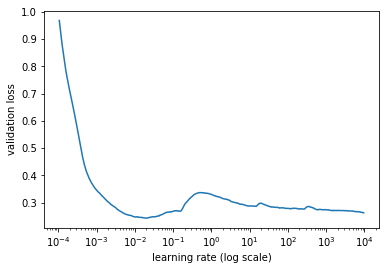

In [50]:
learn.sched.plot()

In [64]:
lr = 1e-2
wd = 1e-7

In [61]:
learn.precompute=True

In [53]:
learn.fit(lr, 1, cycle_len=20, wds=wd, use_clr=(20,10))

epoch      trn_loss   val_loss                                 
    0      0.183582   0.174558  
    1      0.164833   0.159769                                 
    2      0.151082   0.14936                                  
    3      0.149172   0.143523                                 
    4      0.148631   0.143122                                 
    5      0.145783   0.139008                                 
    6      0.144257   0.137208                                 
    7      0.144995   0.138449                                 
    8      0.142653   0.138643                                 
    9      0.144013   0.137162                                 
    10     0.141602   0.138277                                 
    11     0.140366   0.134924                                 
    12     0.138685   0.134399                                 
    13     0.136702   0.133092                                 
    14     0.133267   0.131759                                 
    15 

[array([0.12492])]

In [62]:
learn.bn_freeze(True)

In [56]:
learn.fit(lr, 1, cycle_len=20, wds=wd, use_clr=(20,10))

epoch      trn_loss   val_loss                                  
    0      0.105657   0.124753  
    1      0.113444   0.128986                                 
    2      0.109697   0.1264                                   
    3      0.109042   0.127097                                 
    4      0.109477   0.124734                                 
 89%|████████▉ | 2576/2889 [02:49<00:19, 15.93it/s, loss=0.107]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



    9      0.103252   0.123569                                 
    10     0.103561   0.121598                                  
 95%|█████████▌| 2757/2889 [03:01<00:09, 13.39it/s, loss=0.102] 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



    15     0.096945   0.119645                                  
    16     0.098718   0.119971                                  
    17     0.09374    0.118574                                  
 17%|█▋        | 496/2889 [00:32<02:28, 16.10it/s, loss=0.0928]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [65]:
lrs = np.array([lr/1000,lr/100,lr])

In [66]:
learn.precompute=False
learn.freeze_to(1)

In [67]:
learn.load('pre2')

## Image search

### Search imagenet classes

In [68]:
syns, wvs = list(zip(*syn_wv_1k))
wvs = np.array(wvs)

In [69]:
%time pred_wv = learn.predict()

CPU times: user 8min 21s, sys: 1min 54s, total: 10min 15s
Wall time: 4min 22s


In [75]:
len(pred_wv)

28700

In [417]:
denorm = md.val_ds.denorm

def show_img(im, figsize=None, ax=None, title=None):
    if not ax: fig,ax = plt.subplots(figsize=figsize)
    ax.imshow(im)
    ax.axis('off')
    if title is not None: plt.title(title)
    return ax

def show_imgs(ims, cols, figsize=None, titles=None):
    fig,axes = plt.subplots(len(ims)//cols, cols, figsize=figsize)
    for i,(ax,t) in enumerate(zip(axes.flat, titles)):
        ax.set_title(t)
        show_img(ims[i], ax=ax)
    plt.tight_layout()

In [72]:
syn_wv_1k[0]

('n01440764',
 array([ 0.01299,  0.51545, -0.02986, -0.17743, -0.13517,  0.09963,  0.15457, -0.29894,  0.06537, -0.32881,
        -0.14942,  0.27157, -0.02571, -0.34327, -0.19408, -0.29385,  0.20715,  0.12577, -0.36708, -0.10356,
         0.05554,  0.28829,  0.27081, -0.24148,  0.06971,  0.17108, -0.36212, -0.00102,  0.73211,  0.21934,
         0.38171, -0.27111, -0.05153,  0.22703,  0.63235, -0.34271, -0.16238, -0.02636,  0.12183, -0.27694,
         0.1284 ,  0.11571, -0.05652,  0.10904,  0.58745, -0.49453,  0.00408,  0.23731, -0.35892, -0.23594,
        -0.26689, -0.55627,  0.13677,  0.17301, -0.00451,  0.04068,  0.72272, -0.18249,  0.00439,  0.66343,
         0.26996,  0.18391,  0.19564, -0.32052, -0.08818,  0.07206, -0.50548,  0.14239,  0.13185, -0.0575 ,
         0.00145,  0.04863,  0.28062, -0.27915,  0.14522,  0.33798,  0.52484,  0.1303 ,  0.11702, -0.03346,
         0.21324, -0.07278, -0.23539, -0.15925, -0.05209, -0.36893, -0.27255,  0.25315,  0.18872,  0.07466,
        -0.034

In [78]:
val_names = []
for vc in tqdm(md.val_ds.y):
    for a,b in syn_wv_1k:
        if np.allclose(vc,b):
            val_names.append(a)
            break

100%|██████████| 28700/28700 [05:21<00:00, 89.35it/s] 


In [98]:
start=300

In [419]:
sample_imgs = denorm(md.val_ds[start:start+25][0])
sample_imgs_true_classes = [classids_1k[k] for k in val_names[start:start+25]]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


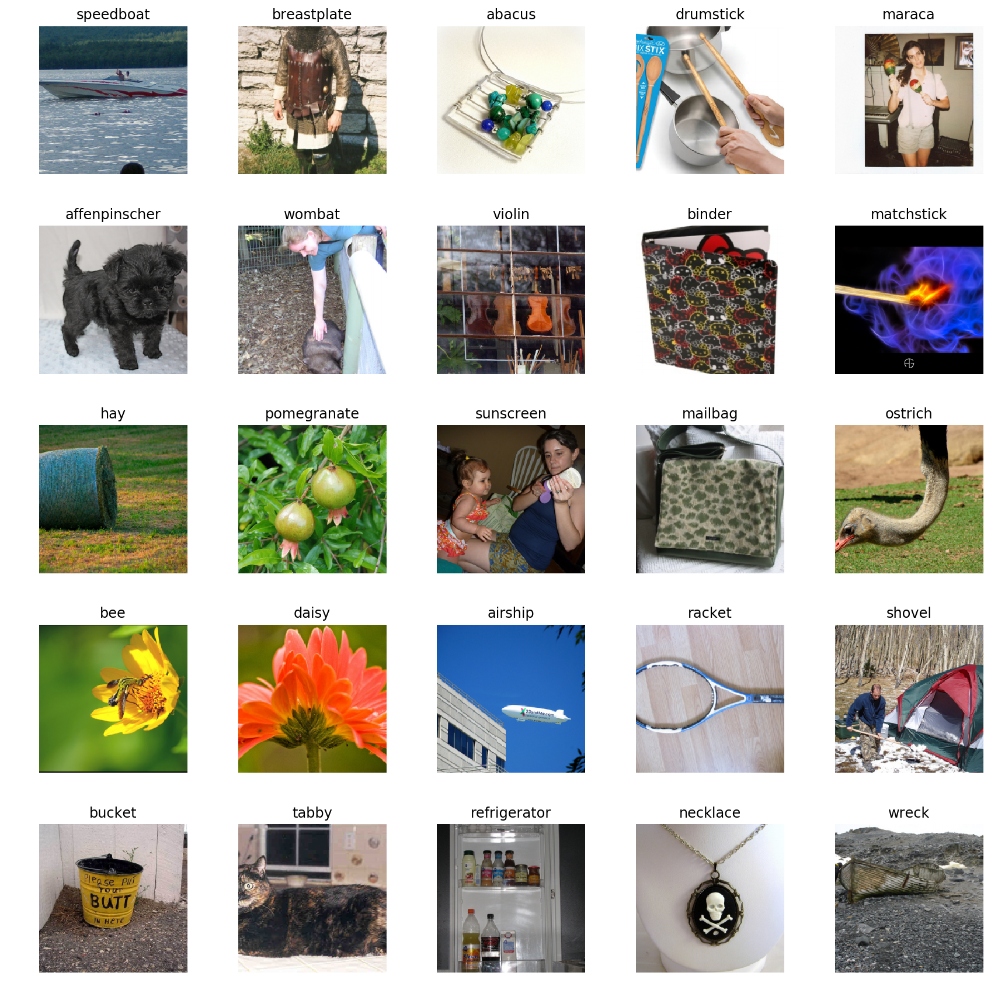

In [421]:
show_imgs(sample_imgs, 5, (12,12), titles=sample_imgs_true_classes)

In [90]:
import nmslib

def create_index(a):
    index = nmslib.init(space='angulardist')
    index.addDataPointBatch(a)
    index.createIndex()
    return index

def get_knns(index, vecs):
     return zip(*index.knnQueryBatch(vecs, k=10, num_threads=4))

def get_knn(index, vec): return index.knnQuery(vec, k=10)

In [537]:
nn_wvs = create_index(wvs)

In [538]:
idxs,dists = get_knns(nn_wvs, pred_wv)

In [539]:
[[classids[syns[id]] for id in ids[:3]] for ids in idxs[start:start+25]]

[['speedboat', 'catamaran', 'jeep'],
 ['cuirass', 'breastplate', 'scabbard'],
 ['abacus', 'sundial', 'pinwheel'],
 ['spatula', 'ladle', 'shovel'],
 ['maraca', 'marimba', 'drum'],
 ['affenpinscher', 'Doberman', 'Weimaraner'],
 ['wombat', 'koala', 'dingo'],
 ['violin', 'cello', 'bassoon'],
 ['binder', 'dough', 'washer'],
 ['matchstick', 'bottlecap', 'tub'],
 ['hay', 'corn', 'wool'],
 ['pomegranate', 'artichoke', 'jackfruit'],
 ['spatula', 'screwdriver', 'ladle'],
 ['purse', 'mailbag', 'wallet'],
 ['ostrich', 'hippopotamus', 'warthog'],
 ['bee', 'ant', 'apiary'],
 ['daisy', 'paintbrush', 'teddy'],
 ['airship', 'airliner', 'balloon'],
 ['racket', 'padlock', 'wallet'],
 ['paddle', 'snorkel', 'catamaran'],
 ['ashcan', 'bucket', 'ballpoint'],
 ['polecat', 'badger', 'coyote'],
 ['refrigerator', 'stove', 'vacuum'],
 ['necklace', 'handkerchief', 'cloak'],
 ['schooner', 'submarine', 'paddlewheel']]

### Search all wordnet noun classes

In [500]:
all_syns, all_wvs = list(zip(*syn2wv.items()))
all_wvs = np.array(all_wvs)

In [540]:
all_syns, all_wvs = list(zip(*syn2wv_new.items()))
all_wvs = np.array(all_wvs)

In [541]:
nn_allwvs = create_index(all_wvs)

In [542]:
idxs,dists = get_knns(nn_allwvs, pred_wv)

In [543]:
[[classids[all_syns[id]] for id in ids[:3]] for ids in idxs[start:start+25]]

[['speedboat', 'motorboat', 'boat'],
 ['cuirass', 'breastplate', 'scabbard'],
 ['abacus', 'calculator', 'gnomon'],
 ['spatula', 'ladle', 'utensil'],
 ['maraca', 'conga', 'marimba'],
 ['affenpinscher', 'pinscher', 'schnauzer'],
 ['wombat', 'kangaroo', 'koala'],
 ['violin', 'cello', 'piano'],
 ['binder', 'bindery', 'gelatin'],
 ['matchstick', 'cardboard', 'tinderbox'],
 ['hay', 'wheat', 'hayfield'],
 ['pomegranate', 'carob', 'apricot'],
 ['spatula', 'fingernail', 'Serratula'],
 ['purse', 'mailbag', 'wallet'],
 ['ostrich', 'giraffe', 'hippopotamus'],
 ['bee', 'honeybee', 'honey'],
 ['daisy', 'lily', 'marigold'],
 ['airship', 'blimp', 'aircraft'],
 ['racket', 'racketeer', 'racketeering'],
 ['paddle', 'snorkel', 'surfboat'],
 ['ashcan', 'silkscreen', 'Warhol'],
 ['squirrel', 'polecat', 'raccoon'],
 ['refrigerator', 'refrigeration', 'refrigerant'],
 ['necklace', 'earring', 'bracelet'],
 ['whaleboat', 'whaler', 'schooner']]

### Text -> image search

In [107]:
nn_predwv = create_index(pred_wv)

In [108]:
en_vecd = pickle.load(open(TRANS_PATH/'wiki.en.pkl','rb'))

In [440]:
def get_images_for_srch(srch, n=3):
    if srch in (set(classids_1k.values())):
        print('class exists in ImageNet\n')
    else:
        print('class does not exist in ImageNet\n')
    vec = en_vecd[srch]
    idxs,dists = get_knn(nn_predwv, vec)
    similar_imgs = [PATH/md.val_ds.fnames[i] for i in idxs[0:n]]
    similar_imgs_titles = []
    for img in similar_imgs:
        vname = img.name.split('.')[0]
        extract = ET.parse(os.path.join(PATH/'ILSVRC/Annotations/CLS-LOC/val/',vname +'.xml'))
        dname = extract.getroot()[-1][0].text
        similar_imgs_titles.append(classids_1k[dname])
    show_imgs([open_image(img) for img in similar_imgs], 3, figsize=(10,10), titles=similar_imgs_titles);

class exists in ImageNet



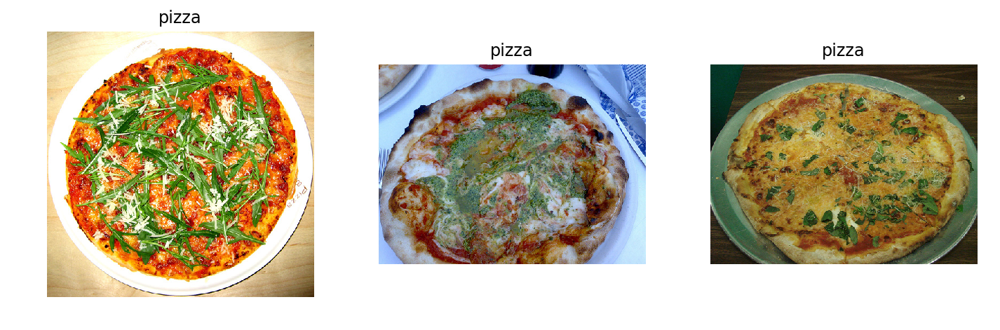

In [554]:
get_images_for_srch('pizza')

class does not exist in ImageNet



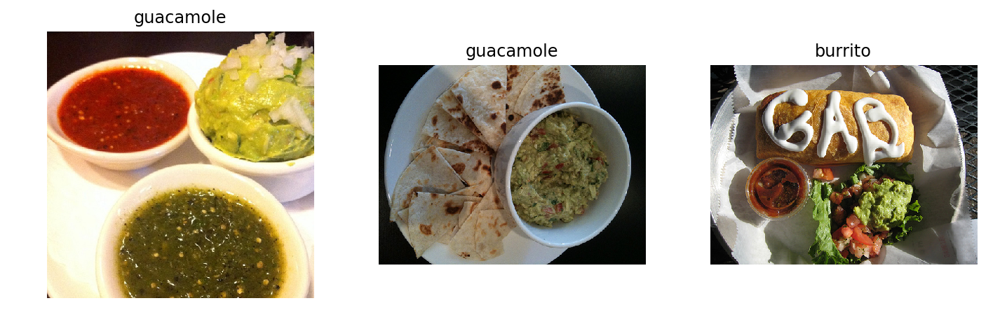

In [442]:
get_images_for_srch('nacho')

class does not exist in ImageNet



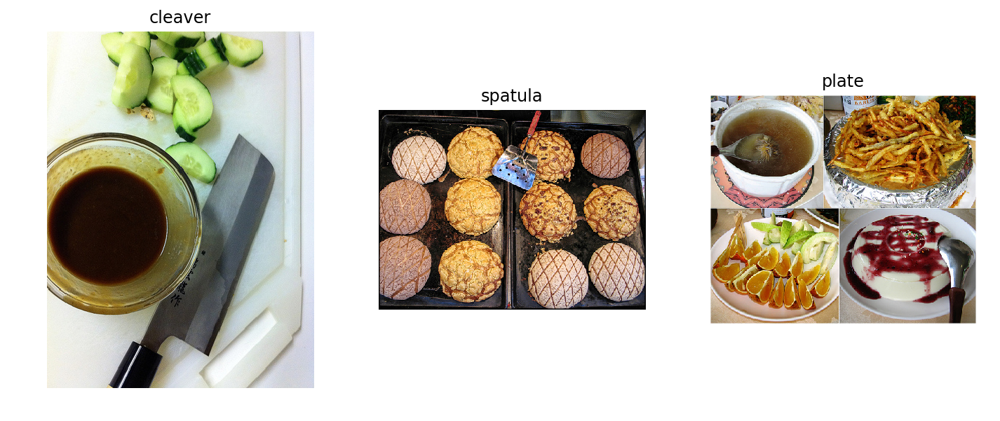

In [443]:
get_images_for_srch('salad')

class does not exist in ImageNet



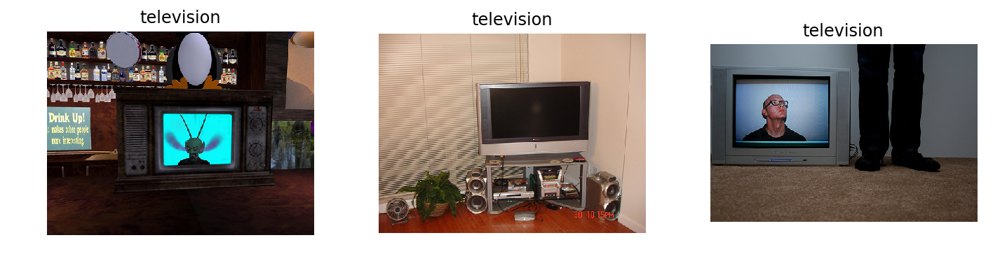

In [649]:
get_images_for_srch('tv')

class does not exist in ImageNet



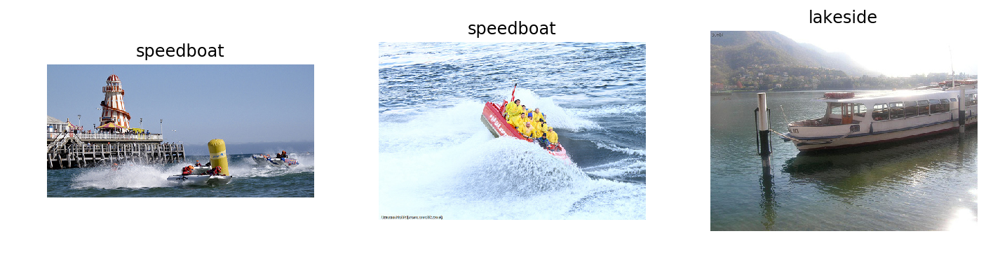

In [444]:
get_images_for_srch('boat')

class exists in ImageNet



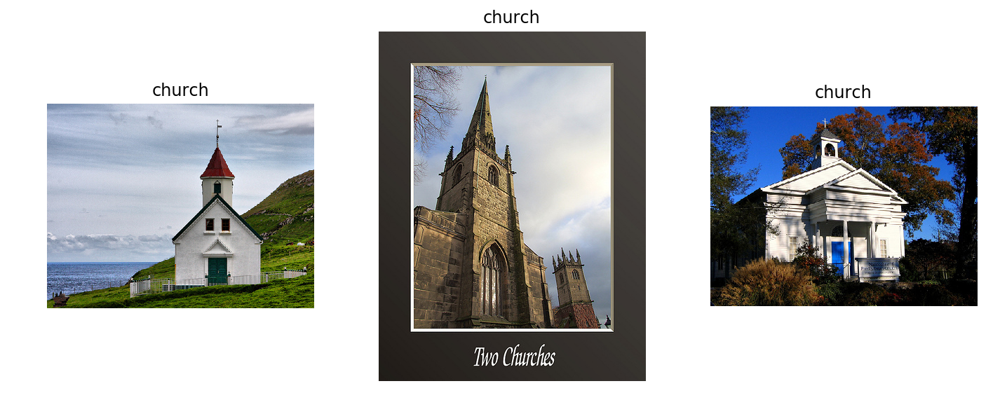

In [445]:
get_images_for_srch('church')

class does not exist in ImageNet



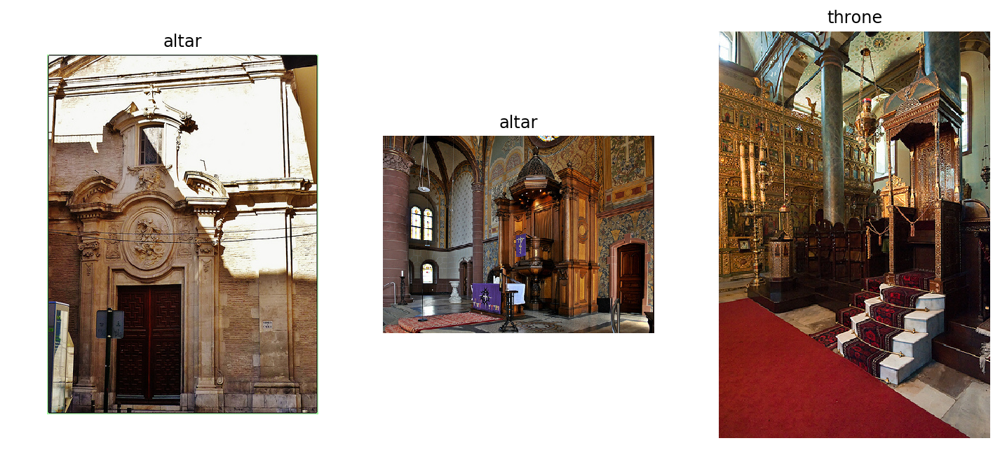

In [446]:
get_images_for_srch('cathedral')

class does not exist in ImageNet



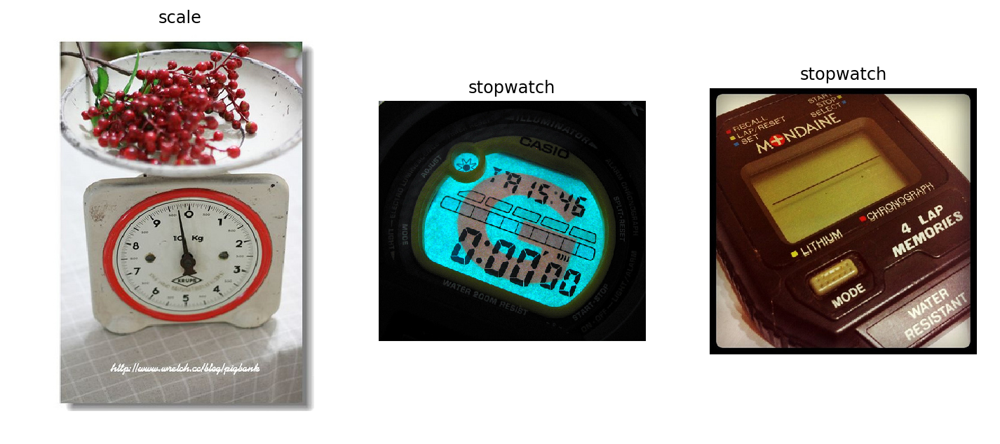

In [447]:
get_images_for_srch('clock')

class does not exist in ImageNet



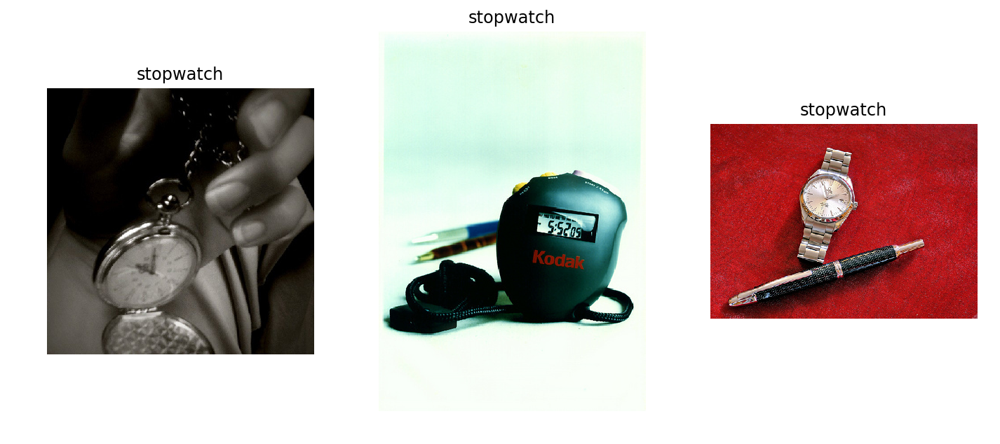

In [448]:
get_images_for_srch('wristwatch')

class does not exist in ImageNet



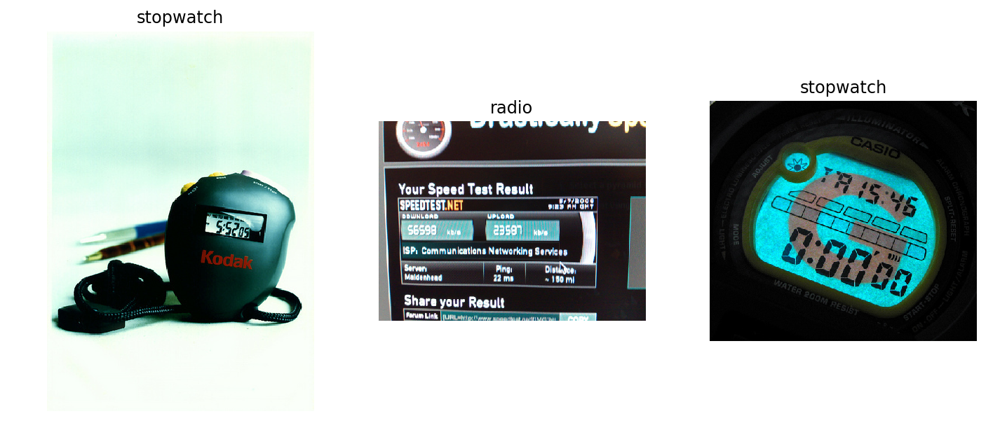

In [449]:
get_images_for_srch('watch')

class does not exist in ImageNet



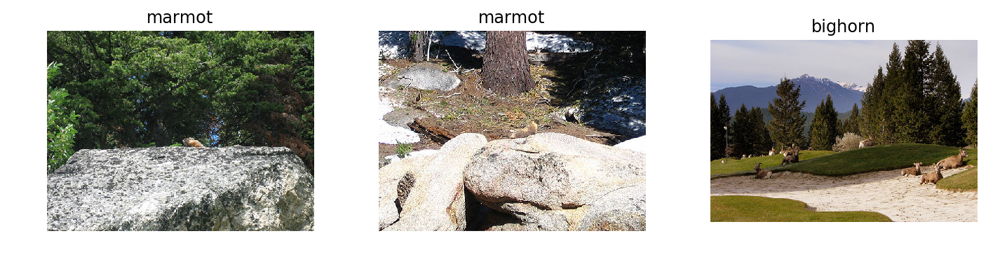

In [575]:
get_images_for_srch('forest')

In [602]:
def get_images_for_vec(vec, n=3):
    idxs,dists = get_knn(nn_predwv, vec)
    similar_imgs = [PATH/md.val_ds.fnames[i] for i in idxs[0:n]]
    similar_imgs_titles = []
    for img in similar_imgs:
        vname = img.name.split('.')[0]
        extract = ET.parse(os.path.join(PATH/'ILSVRC/Annotations/CLS-LOC/val/',vname +'.xml'))
        dname = extract.getroot()[-1][0].text
        similar_imgs_titles.append(classids_1k[dname])
    show_imgs([open_image(img) for img in similar_imgs], 3, figsize=(10,10), titles=similar_imgs_titles);

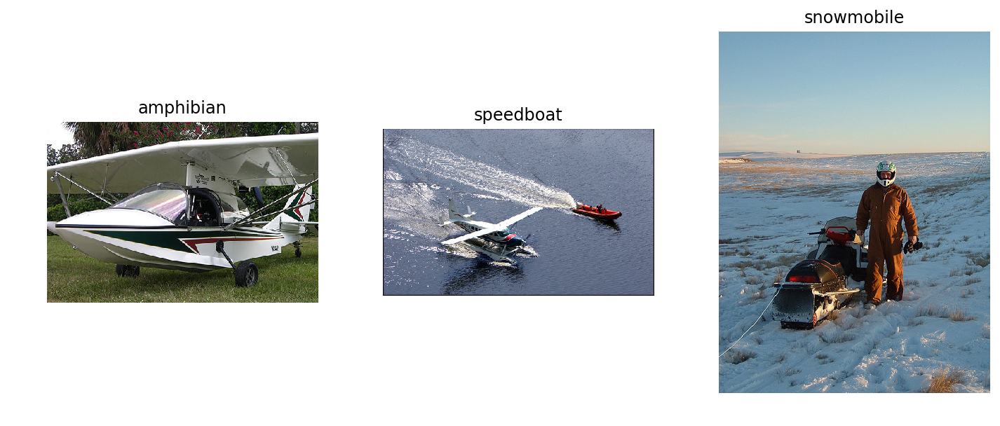

In [453]:
vec = (en_vecd['engine'] + en_vecd['boat'])/2
get_images_for_vec(vec, 3)

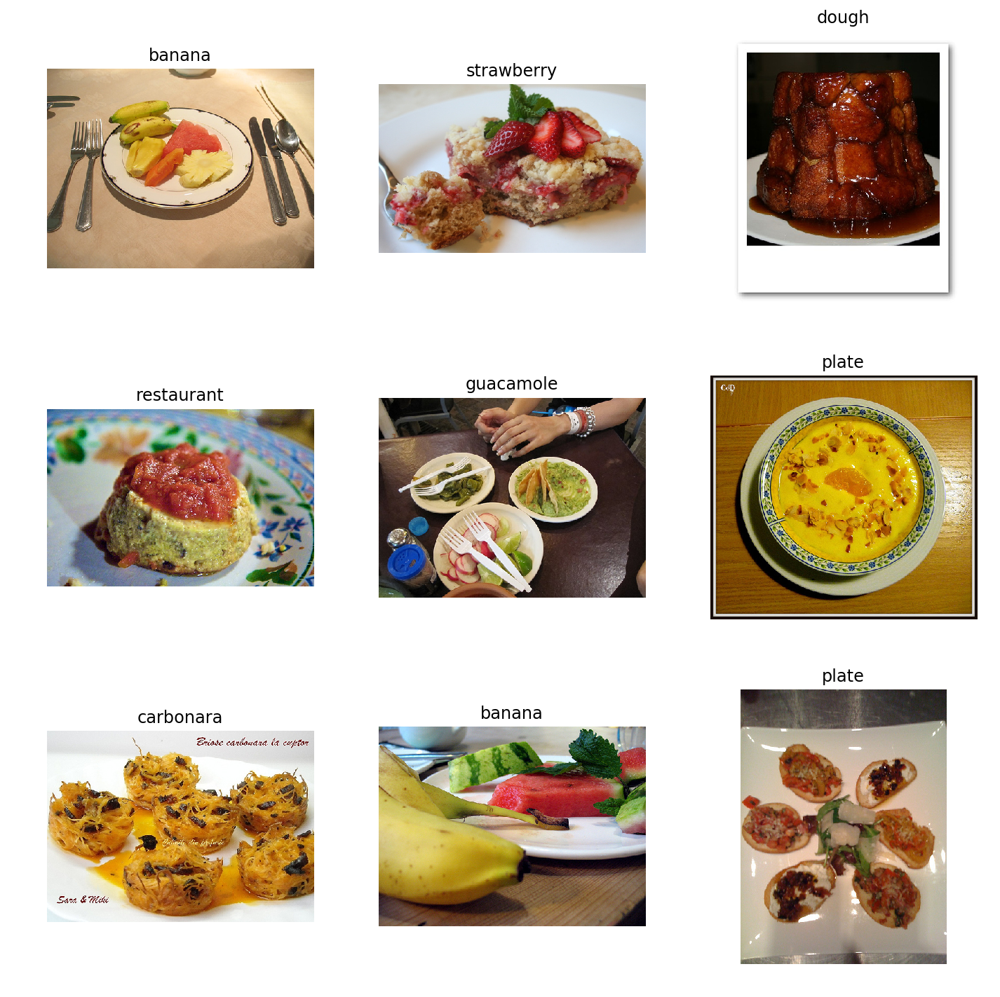

In [454]:
vec = (en_vecd['banana'] + en_vecd['plate'])/2
get_images_for_vec(vec,9)

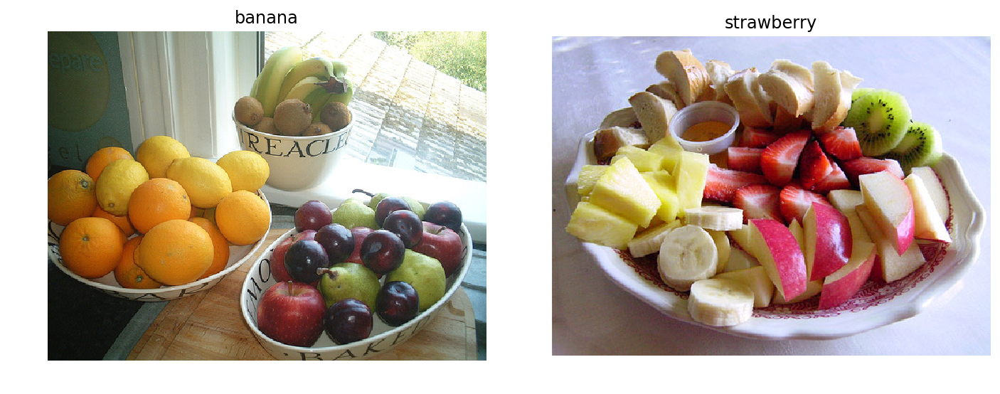

In [601]:
vec = (en_vecd['banana'] + en_vecd['apple'])/2
get_images_for_vec(vec,2)

class exists in ImageNet



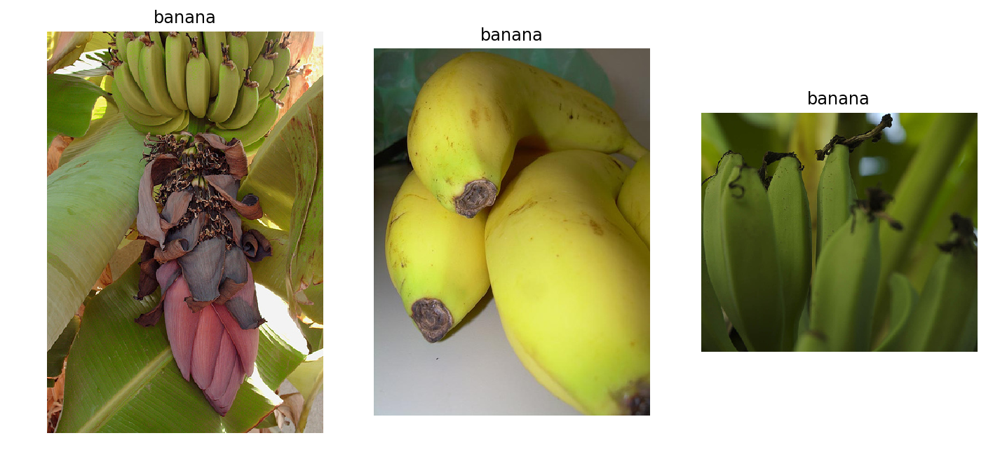

In [455]:
get_images_for_srch('banana')

class exists in ImageNet



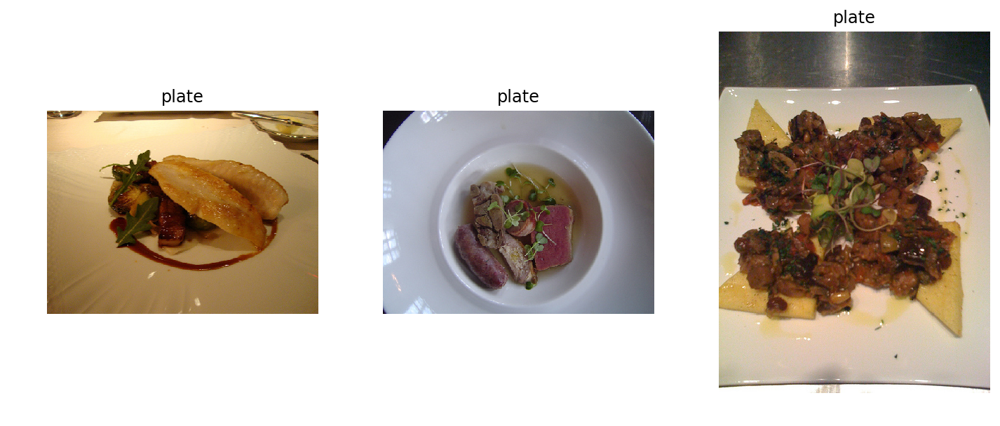

In [456]:
get_images_for_srch('plate')

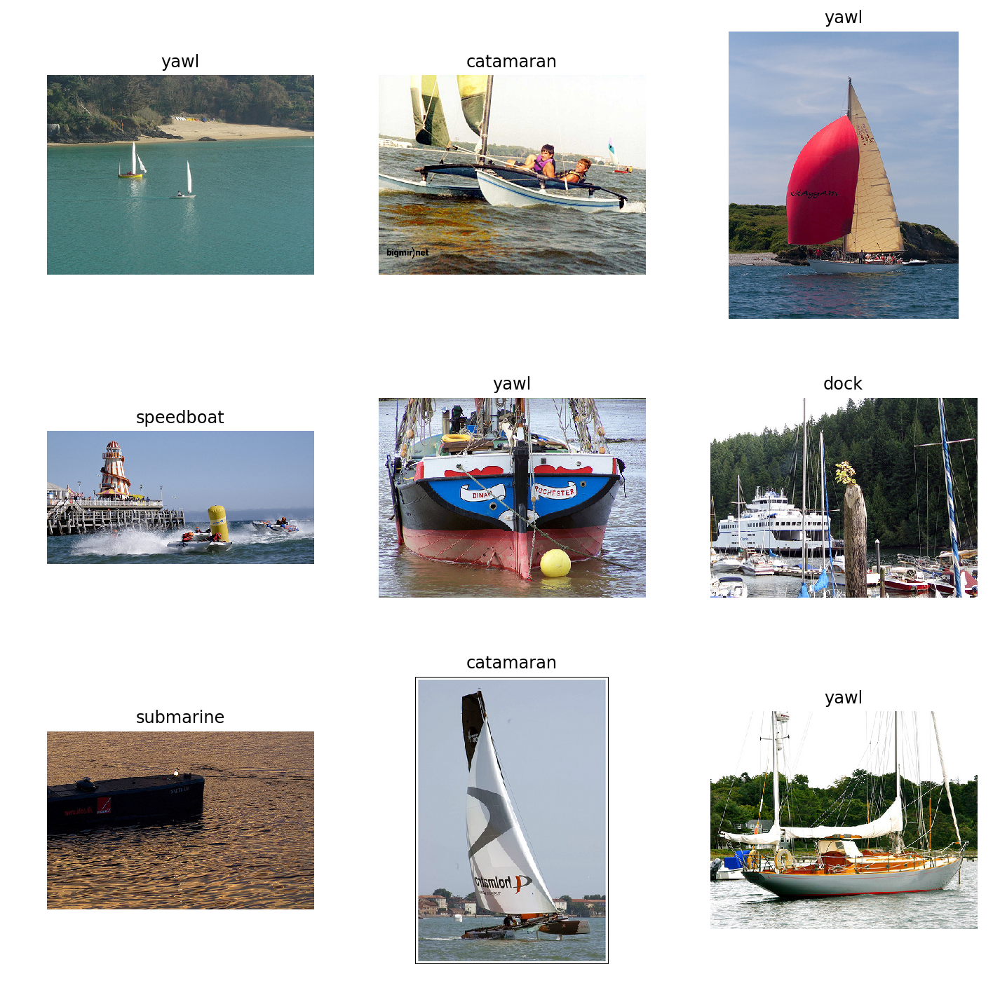

In [457]:
vec = (en_vecd['sail'] + en_vecd['boat'])/2
get_images_for_vec(vec,9)

class does not exist in ImageNet



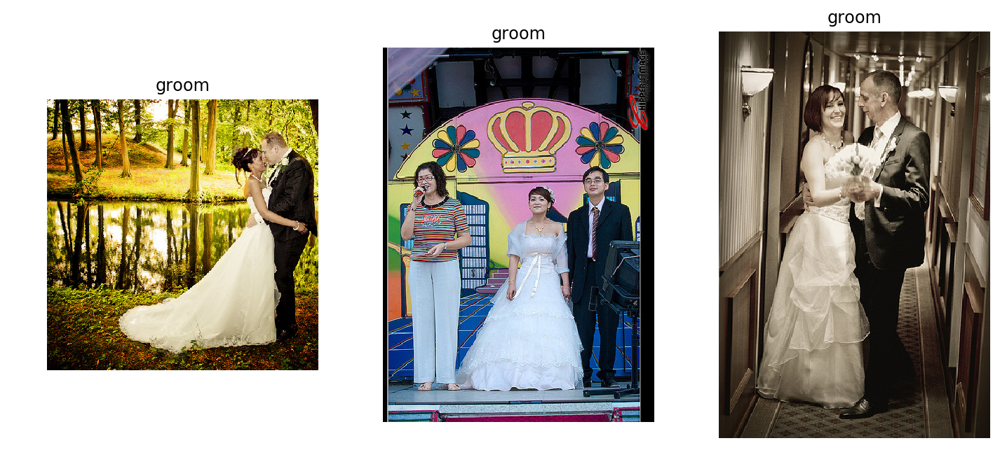

In [609]:
get_images_for_srch('wedding')

class does not exist in ImageNet



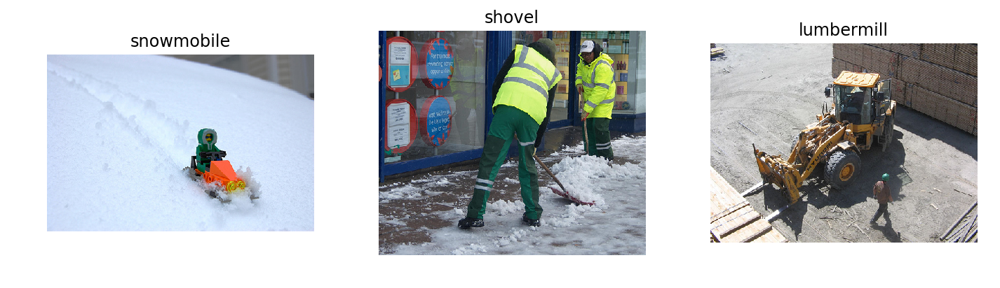

In [550]:
get_images_for_srch('snow')

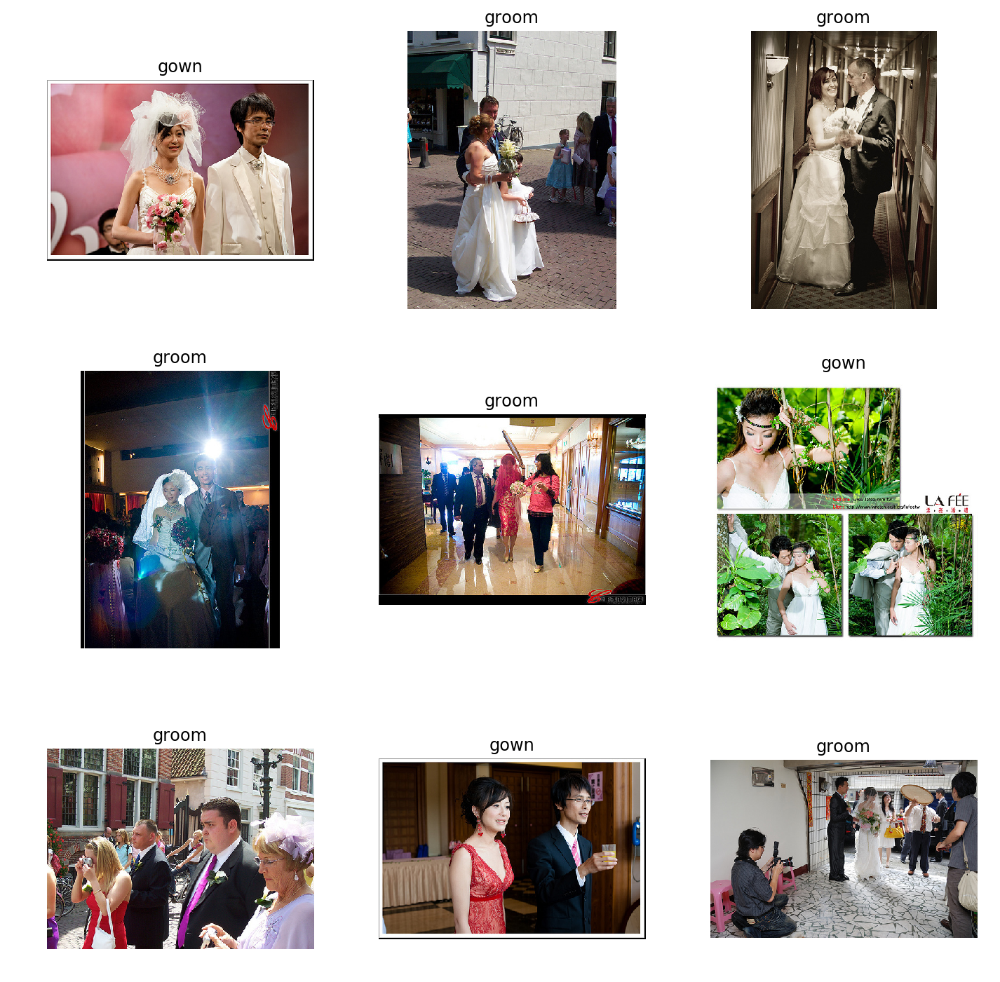

In [613]:
vec = (0.5*en_vecd['wedding'] + 0.5*en_vecd['groom'])
get_images_for_vec(vec,9)

### Image->image

In [568]:
def get_similar_imgs(img, n=3):
    t_img = md.val_ds.transform(img)
    pred = learn.predict_array(t_img[None])
    idxs,dists = get_knn(nn_predwv, pred)
    print('similar images')
    show_imgs([open_image(PATH/md.val_ds.fnames[i]) for i in idxs[1:1+n]], 3, figsize=(9,3), titles=['']*n);

In [311]:
fname = 'ILSVRC/Data/CLS-LOC/val/ILSVRC2012_val_00007197.JPEG'

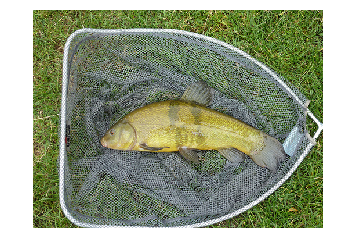

In [312]:
img = open_image(PATH/fname); show_img(img);

similar images


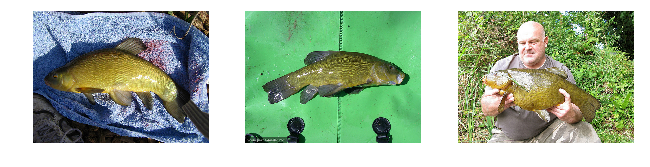

In [316]:
get_similar_imgs(img)

In [301]:
fname = 'ILSVRC/Data/CLS-LOC/val/ILSVRC2012_val_00030393.JPEG'

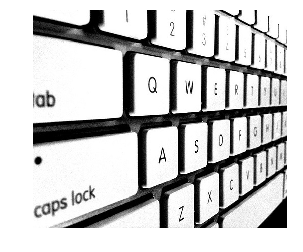

In [302]:
img = open_image(PATH/fname); show_img(img);

similar images


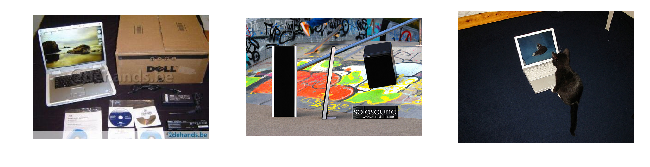

In [303]:
get_similar_imgs(img)

In [383]:
fname = 'ILSVRC/Data/CLS-LOC/val/ILSVRC2012_val_00033601.JPEG'

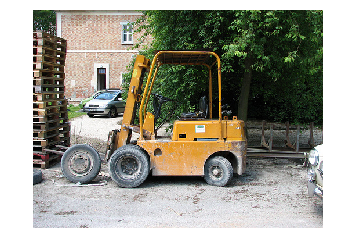

In [384]:
img = open_image(PATH/fname); show_img(img);

similar images


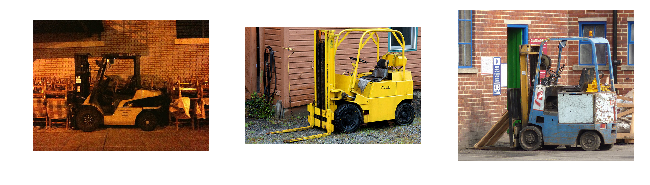

In [306]:
get_similar_imgs(img)

In [565]:
fname = 'ILSVRC/Data/CLS-LOC/val/ILSVRC2012_val_00033601.JPEG'

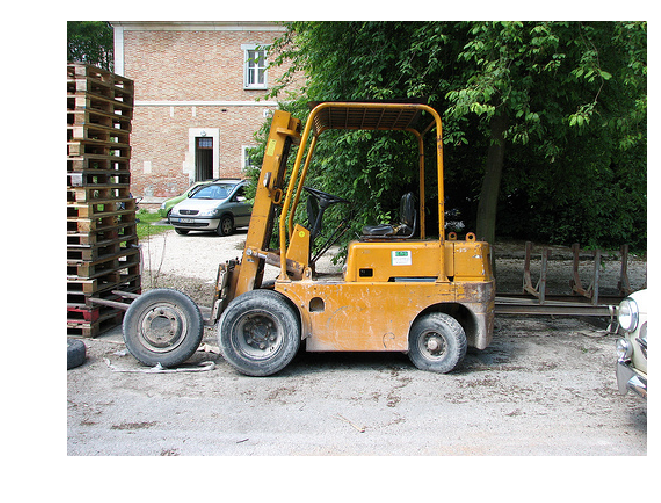

In [569]:
img = open_image(PATH/fname); show_img(img);

similar images


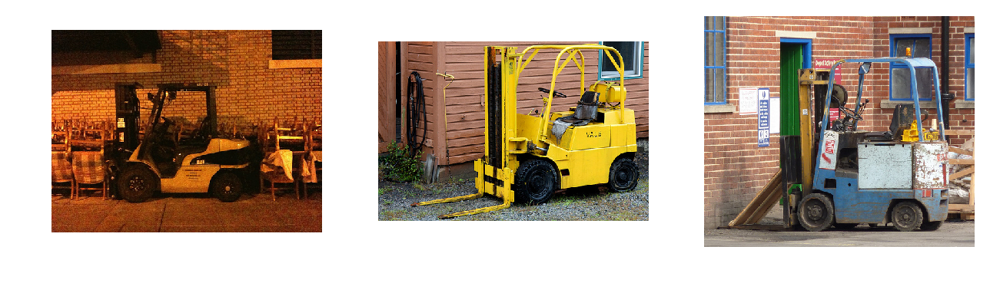

In [570]:
get_similar_imgs(img)

In [307]:
fname = 'ILSVRC/Data/CLS-LOC/val/ILSVRC2012_val_00005900.JPEG'

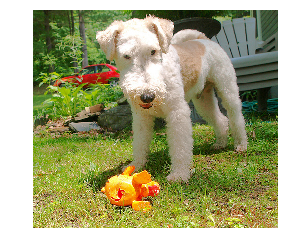

In [308]:
img = open_image(PATH/fname); show_img(img);

similar images


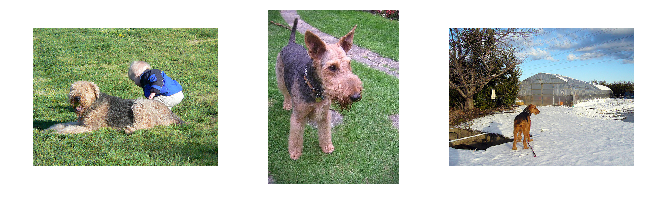

In [309]:
get_similar_imgs(img)

In [571]:
fname = 'images/teddy_bear.jpg'

In [640]:
fname = 'images/new_image.jpg'

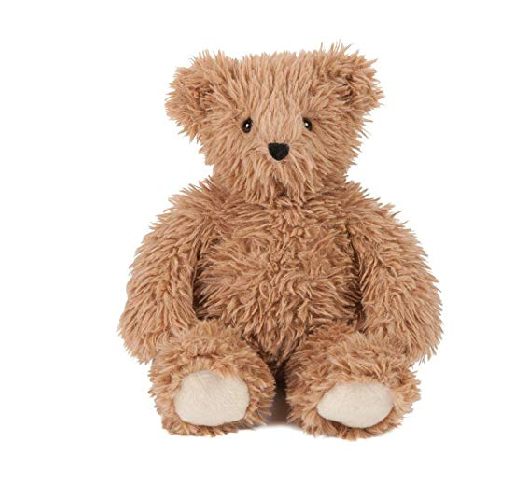

In [572]:
img = open_image(fname); show_img(img);

similar images


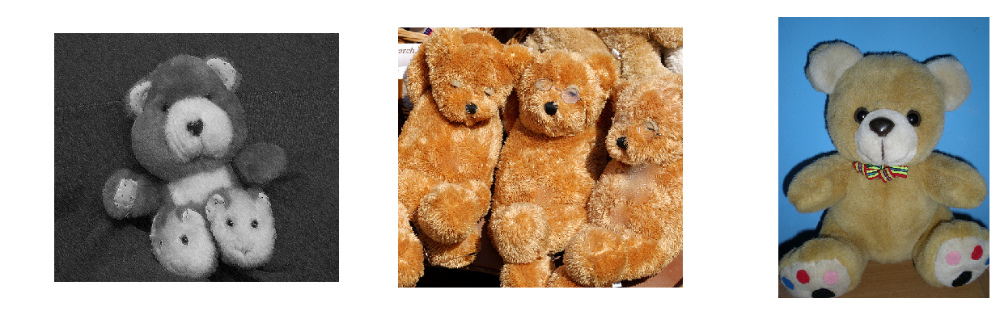

In [573]:
get_similar_imgs(img)